In [1]:
import tensorflow as tf

import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
import random 
import os
import PIL.Image
import cv2
import random
from PIL import Image

In [2]:
tf.__version__

'2.4.0'

In [3]:
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


In [4]:
base_model = tf.keras.applications.InceptionV3(include_top = False, weights = 'imagenet')

87916544/87910968 [==============================] - 2s 0us/step


In [5]:
base_model.summary()

Model: "inception_v3"
__________________________________________________________________________________________________
Layer (type)                    Output Shape         Param #     Connected to                     
input_1 (InputLayer)            [(None, None, None,  0                                            
__________________________________________________________________________________________________
conv2d (Conv2D)                 (None, None, None, 3 864         input_1[0][0]                    
__________________________________________________________________________________________________
batch_normalization (BatchNorma (None, None, None, 3 96          conv2d[0][0]                     
__________________________________________________________________________________________________
activation (Activation)         (None, None, None, 3 0           batch_normalization[0][0]        
_______________________________________________________________________________________

In [6]:
img_1 = Image.open("/content/drive/My Drive/DataSets/Creative AI Dataset/mars.jpg")
img_2 = Image.open('/content/drive/My Drive/DataSets/Creative AI Dataset/eiffel.jpg')
image = Image.blend(img_1, img_2, 0.5)
image.save("img_0.jpg")

In [7]:
Sample_Image = tf.keras.preprocessing.image.load_img('img_0.jpg')

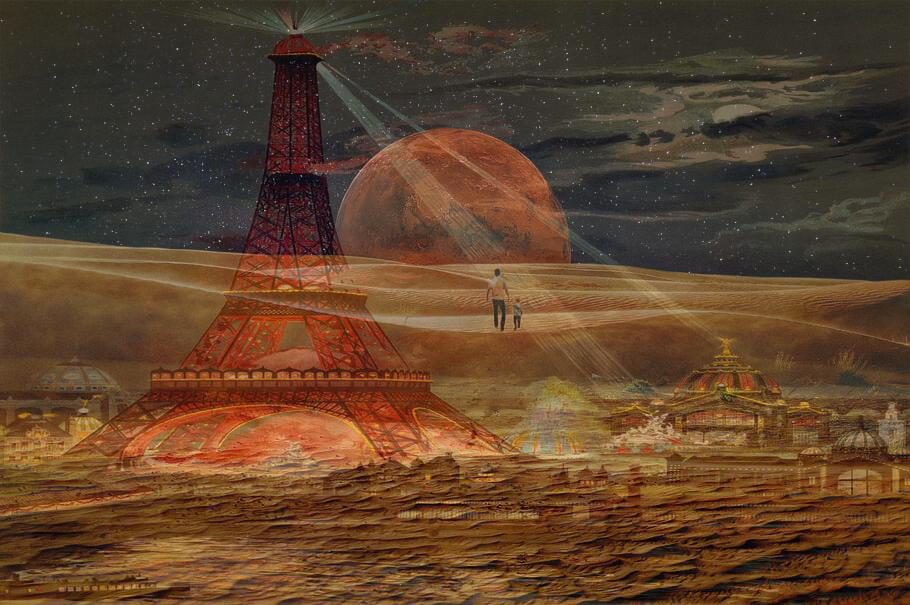

In [8]:
Sample_Image

In [9]:
np.shape(Sample_Image)

(605, 910, 3)

In [10]:
type(Sample_Image)

PIL.JpegImagePlugin.JpegImageFile

In [11]:
Sample_Image = tf.keras.preprocessing.image.img_to_array(Sample_Image)
type(Sample_Image)

numpy.ndarray

In [12]:
print('min pixel values = {}, max pixel values = {}'.format(Sample_Image.min(), Sample_Image.max()))

min pixel values = 0.0, max pixel values = 255.0


In [13]:
Sample_Image = np.array(Sample_Image)/255.0
Sample_Image.shape

(605, 910, 3)

In [14]:
print('min pixel values = {}, max pixel values = {}'.format(Sample_Image.min(), Sample_Image.max()))

min pixel values = 0.0, max pixel values = 1.0


In [15]:
Sample_Image = tf.expand_dims(Sample_Image, axis = 0)
#changing dimension to 4D

In [16]:
np.shape(Sample_Image)

TensorShape([1, 605, 910, 3])

Note : To remove dimension - np.squeeze

In [17]:
names = ['mixed3', 'mixed5', 'mixed7']
layers = [base_model.get_layer(name).output for name in names]
deepdream_model = tf.keras.Model(inputs = base_model.input, outputs = layers)

In [18]:
deepdream_model.summary()

Model: "model"
__________________________________________________________________________________________________
Layer (type)                    Output Shape         Param #     Connected to                     
input_1 (InputLayer)            [(None, None, None,  0                                            
__________________________________________________________________________________________________
conv2d (Conv2D)                 (None, None, None, 3 864         input_1[0][0]                    
__________________________________________________________________________________________________
batch_normalization (BatchNorma (None, None, None, 3 96          conv2d[0][0]                     
__________________________________________________________________________________________________
activation (Activation)         (None, None, None, 3 0           batch_normalization[0][0]        
______________________________________________________________________________________________

In [19]:
activations = deepdream_model(Sample_Image)
activations

[<tf.Tensor: shape=(1, 36, 55, 768), dtype=float32, numpy=
 array([[[[0.        , 0.        , 0.        , ..., 0.02111706,
           0.4271374 , 0.3067971 ],
          [0.        , 0.13667119, 0.        , ..., 0.        ,
           0.        , 0.        ],
          [0.        , 0.25661847, 0.        , ..., 0.        ,
           0.07347696, 0.        ],
          ...,
          [0.        , 0.        , 0.        , ..., 0.        ,
           0.        , 0.        ],
          [0.        , 0.        , 0.        , ..., 0.42646638,
           0.        , 0.        ],
          [0.05945823, 0.        , 0.        , ..., 0.42646638,
           0.6412625 , 0.        ]],
 
         [[0.67514056, 0.        , 0.        , ..., 0.02111706,
           0.28741294, 0.6544863 ],
          [0.        , 0.        , 0.        , ..., 0.        ,
           0.        , 0.2224127 ],
          [0.        , 0.        , 0.        , ..., 0.        ,
           0.        , 0.        ],
          ...,
        

In [20]:
len(activations)

3

In [21]:
x = tf.constant(2.0)

In [22]:
with tf.GradientTape() as g:
  g.watch(x)
  y = x*x*x
dy_dx = g.gradient(y, x)

In [23]:
dy_dx

<tf.Tensor: shape=(), dtype=float32, numpy=12.0>

In [24]:
x = tf.constant(5.0)

In [25]:
with tf.GradientTape() as g:
  g.watch(x)
  y = x**4 + x**5
dy_dx = g.gradient(y, x)

In [26]:
dy_dx

<tf.Tensor: shape=(), dtype=float32, numpy=3625.0>

# Implementing Deep Dream Algorithm

In [27]:
Sample_Image.shape

TensorShape([1, 605, 910, 3])

In [28]:
Sample_Image = tf.squeeze(Sample_Image, axis = 0)

In [29]:
Sample_Image.shape

TensorShape([605, 910, 3])

In [30]:
def calc_loss(image, model):
  img_batch = tf.expand_dims(image, axis=0) # Convert into batch format
  layer_activations = model(img_batch) # Run the model
  print('ACTIVATION VALUES (LAYER OUTPUT) =\n', layer_activations)

  losses = [] # accumulator to hold all the losses
  for act in layer_activations:
    loss = tf.math.reduce_mean(act) # calculate mean of each activation 
    losses.append(loss)

  print('LOSSES (FROM MULTIPLE ACTIVATION LAYERS) = ', losses)
  print('LOSSES SHAPE (FROM MULTIPLE ACTIVATION LAYERS) = ', np.shape(losses))
  print('SUM OF ALL LOSSES (FROM ALL SELECTED LAYERS)= ', tf.reduce_sum(losses))

  return  tf.reduce_sum(losses)

In [31]:
loss = calc_loss(tf.Variable(Sample_Image), deepdream_model)

ACTIVATION VALUES (LAYER OUTPUT) =
 [<tf.Tensor: shape=(1, 36, 55, 768), dtype=float32, numpy=
array([[[[0.        , 0.        , 0.        , ..., 0.02111706,
          0.4271374 , 0.3067971 ],
         [0.        , 0.13667119, 0.        , ..., 0.        ,
          0.        , 0.        ],
         [0.        , 0.25661847, 0.        , ..., 0.        ,
          0.07347696, 0.        ],
         ...,
         [0.        , 0.        , 0.        , ..., 0.        ,
          0.        , 0.        ],
         [0.        , 0.        , 0.        , ..., 0.42646638,
          0.        , 0.        ],
         [0.05945823, 0.        , 0.        , ..., 0.42646638,
          0.6412625 , 0.        ]],

        [[0.67514056, 0.        , 0.        , ..., 0.02111706,
          0.28741294, 0.6544863 ],
         [0.        , 0.        , 0.        , ..., 0.        ,
          0.        , 0.2224127 ],
         [0.        , 0.        , 0.        , ..., 0.        ,
          0.        , 0.        ],
       

In [32]:
loss

<tf.Tensor: shape=(), dtype=float32, numpy=0.5577076>

In [33]:
@tf.function
def deepdream(model, image, step_size):
    with tf.GradientTape() as tape:
      tape.watch(image)
      loss = calc_loss(image, model) # call the function that calculate the loss 

    # Calculate the gradient of the loss with respect to the pixels of the input image.
    # The syntax : dy_dx = g.gradient(y, x) 
    gradients = tape.gradient(loss, image)

    print('GRADIENTS =\n', gradients)
    print('GRADIENTS SHAPE =\n', np.shape(gradients))

    # tf.math.reduce_std computes the standard deviation of elements across dimensions of a tensor
    gradients /= tf.math.reduce_std(gradients)  

    # In gradient ascent, the "loss" is maximized so that the input image increasingly "excites" the layers.
    # Can update the image by directly adding the gradients (because they're the same shape!)

    image = image + gradients * step_size # X_new = X_old + dy/dx * learning_rate
    image = tf.clip_by_value(image, -1, 1) #making sure that it does not exceed the value of pixels

    return loss, image

In [34]:
def run_deep_dream_simple(model, image, steps = 100, step_size = 0.01):
  # Convert from uint8 to the range expected by the model.
  image = tf.keras.applications.inception_v3.preprocess_input(image)

  for step in range(steps):
    loss, image = deepdream(model, image, step_size)
    
    if step % 100 == 0:
      plt.figure(figsize=(12,12))
      plt.imshow(deprocess(image))
      plt.show()
      print ("Step {}, loss {}".format(step, loss))

  # clear_output(wait=True)
  plt.figure(figsize=(12,12))
  plt.imshow(deprocess(image))
  plt.show()

  return deprocess(image)

In [35]:
def deprocess(image):
  image = 255*(image + 1.0)/2.0
  return tf.cast(image, tf.uint8)

In [36]:
Sample_Image.shape

TensorShape([605, 910, 3])

ACTIVATION VALUES (LAYER OUTPUT) =
 [<tf.Tensor 'model/mixed3/concat:0' shape=(1, 36, 55, 768) dtype=float32>, <tf.Tensor 'model/mixed5/concat:0' shape=(1, 36, 55, 768) dtype=float32>, <tf.Tensor 'model/mixed7/concat:0' shape=(1, 36, 55, 768) dtype=float32>]
LOSSES (FROM MULTIPLE ACTIVATION LAYERS) =  [<tf.Tensor 'Mean:0' shape=() dtype=float32>, <tf.Tensor 'Mean_1:0' shape=() dtype=float32>, <tf.Tensor 'Mean_2:0' shape=() dtype=float32>]
LOSSES SHAPE (FROM MULTIPLE ACTIVATION LAYERS) =  (3,)
SUM OF ALL LOSSES (FROM ALL SELECTED LAYERS)=  Tensor("Sum:0", shape=(), dtype=float32)
GRADIENTS =
 Tensor("gradient_tape/Reshape_4:0", shape=(605, 910, 3), dtype=float32)
GRADIENTS SHAPE =
 (605, 910, 3)


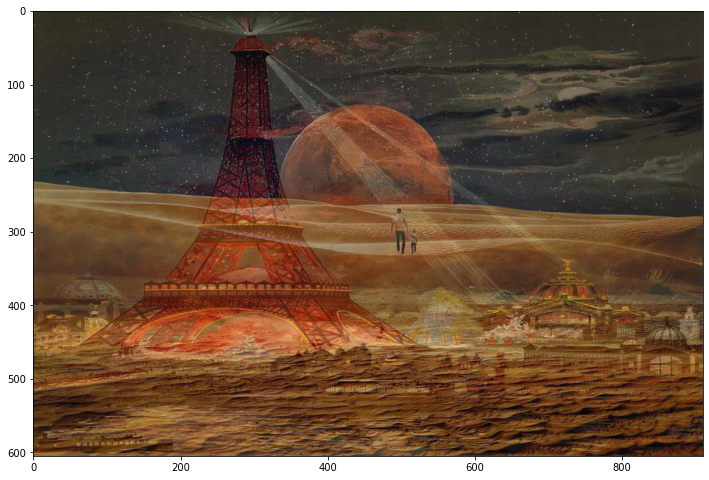

Step 0, loss 0.5804304480552673


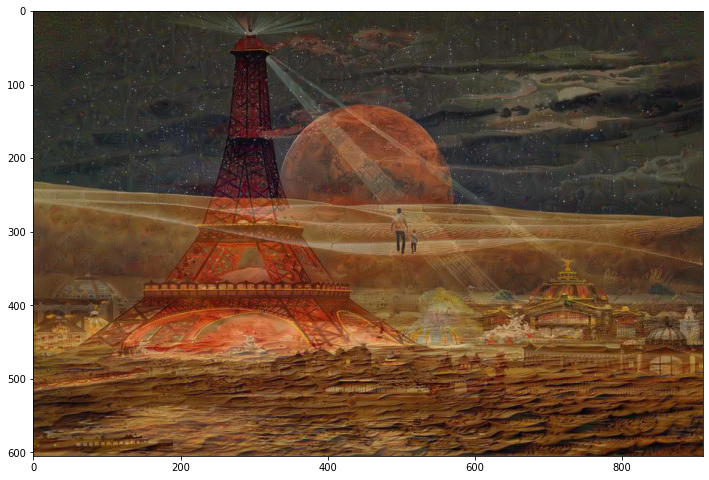

Step 100, loss 1.2815184593200684


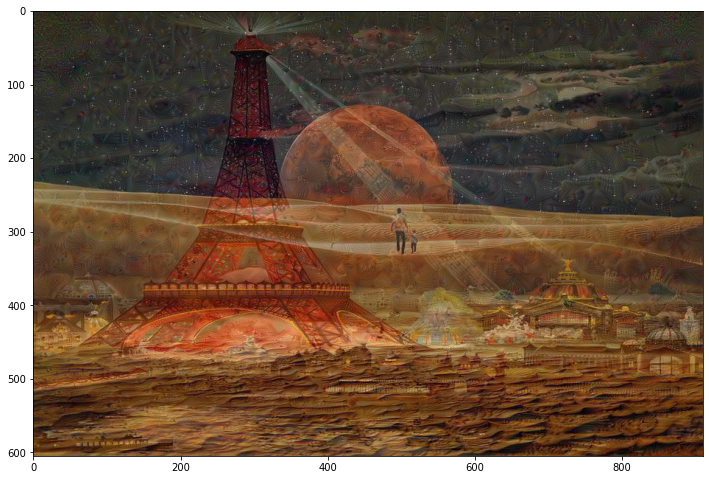

Step 200, loss 1.498436689376831


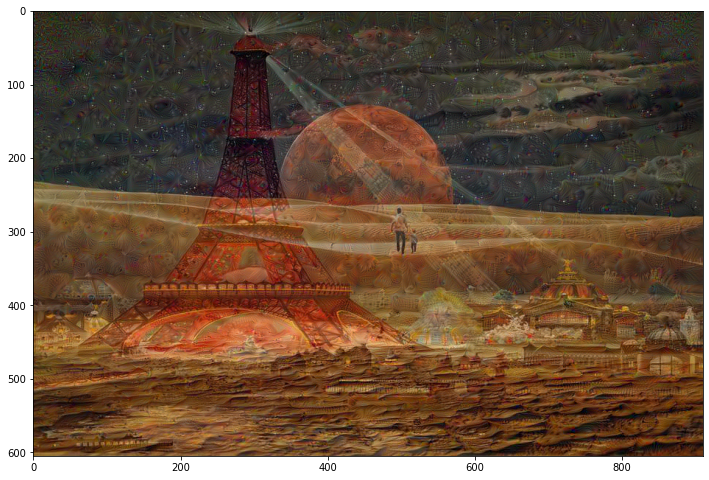

Step 300, loss 1.6355642080307007


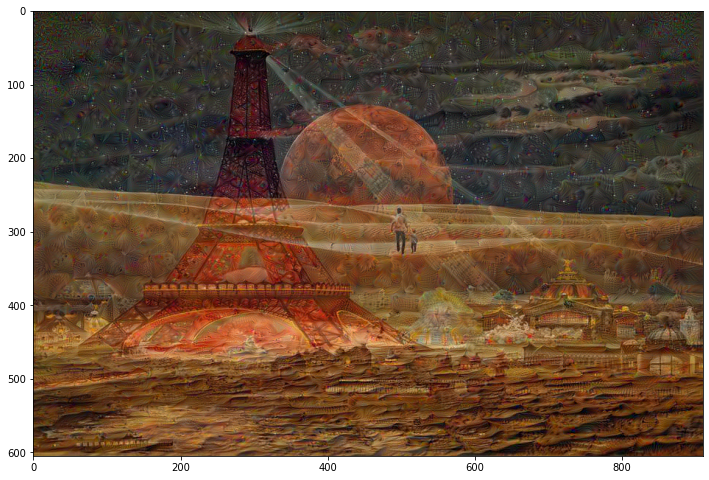

Step 400, loss 1.7389614582061768


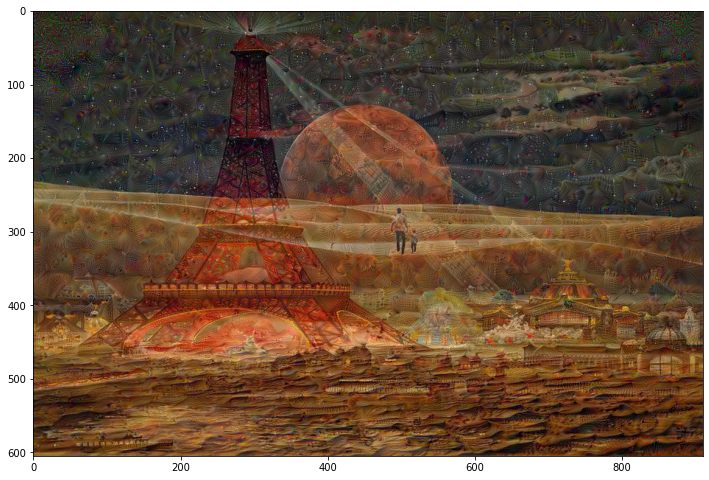

Step 500, loss 1.8217153549194336


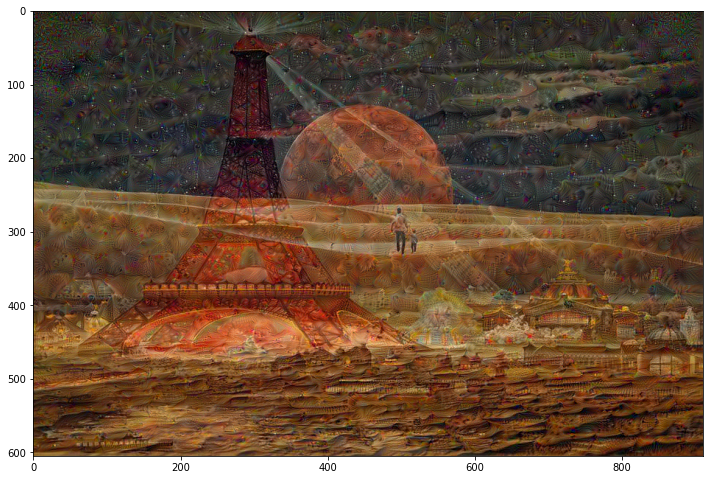

Step 600, loss 1.8924508094787598


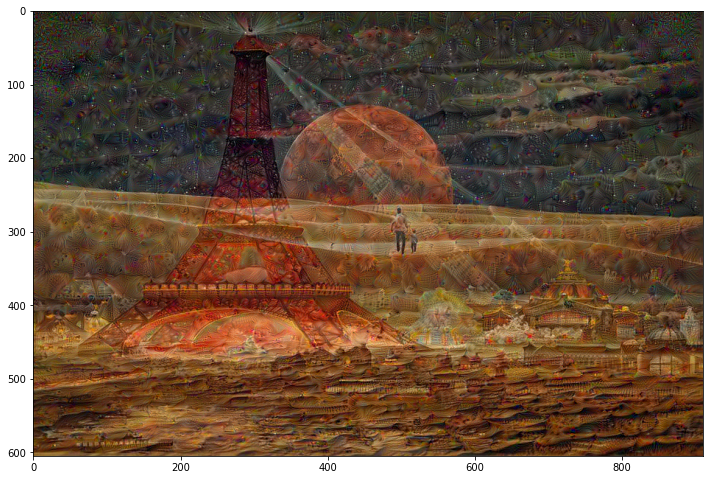

Step 700, loss 1.953650951385498


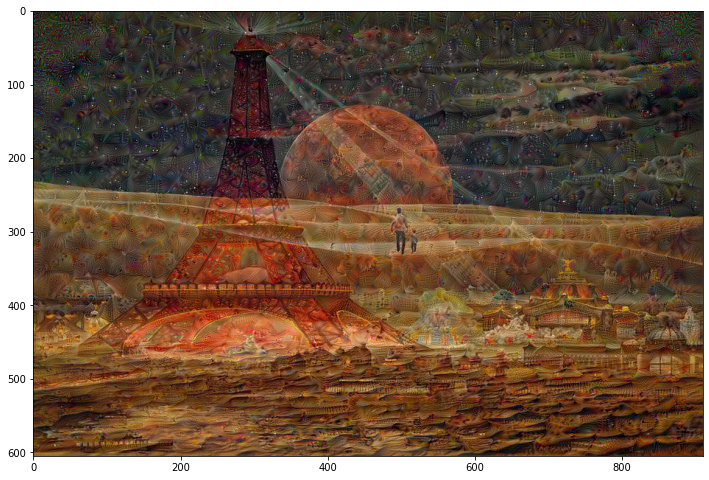

Step 800, loss 2.0073390007019043


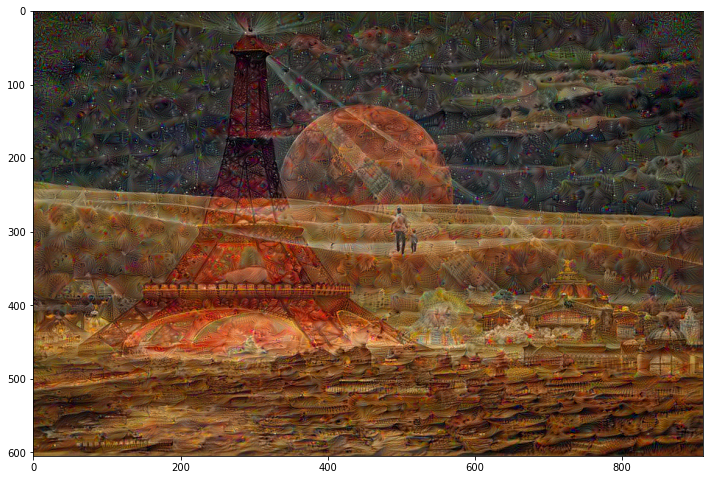

Step 900, loss 2.0540037155151367


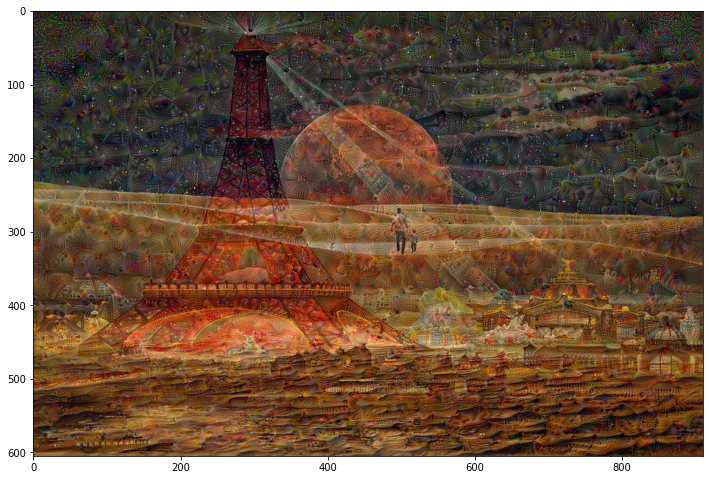

Step 1000, loss 2.09533953666687


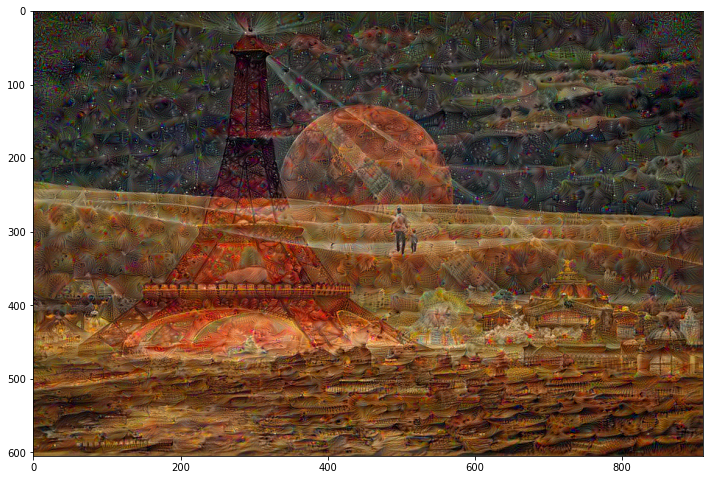

Step 1100, loss 2.133225917816162


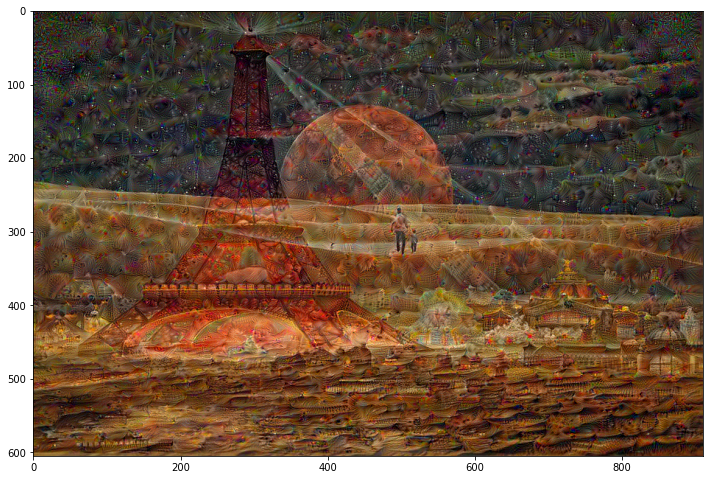

Step 1200, loss 2.168311834335327


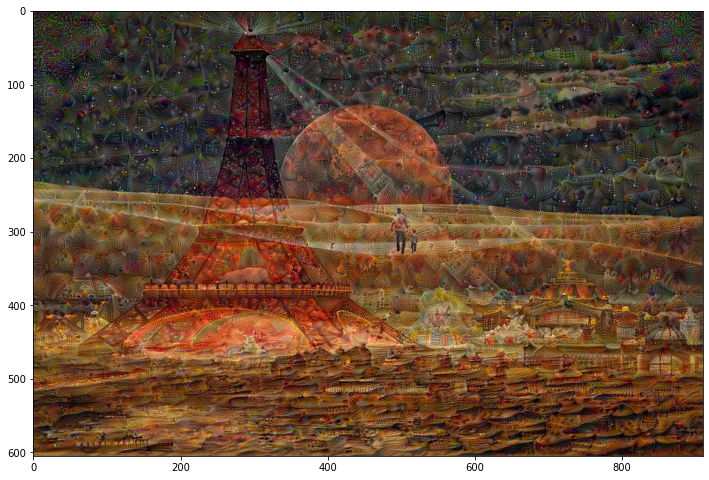

Step 1300, loss 2.200997829437256


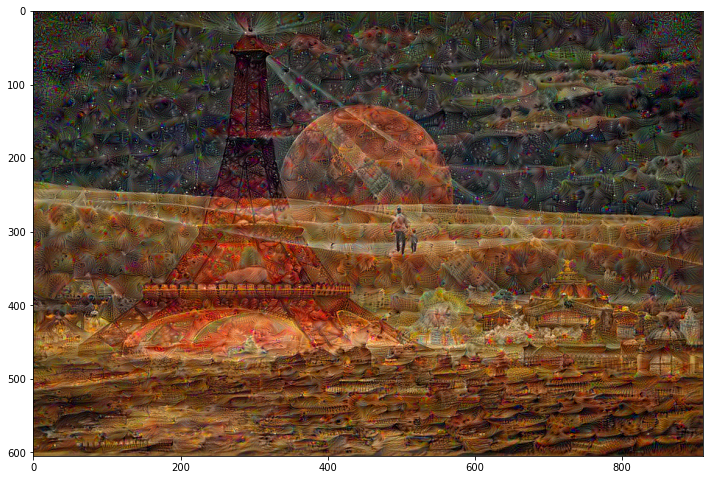

Step 1400, loss 2.2317662239074707


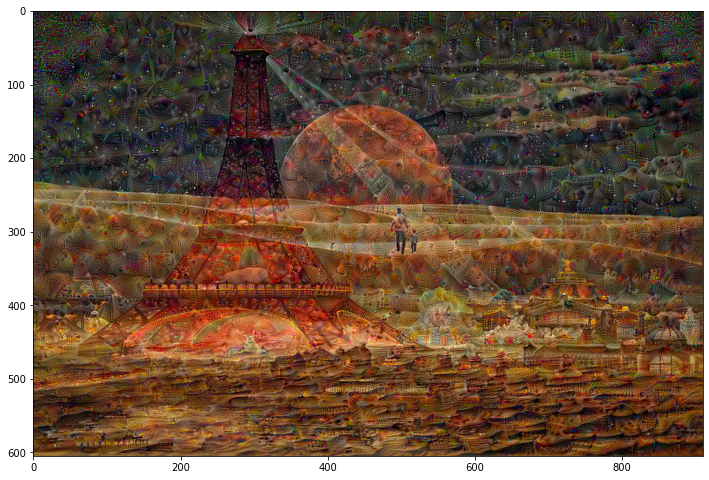

Step 1500, loss 2.2607946395874023


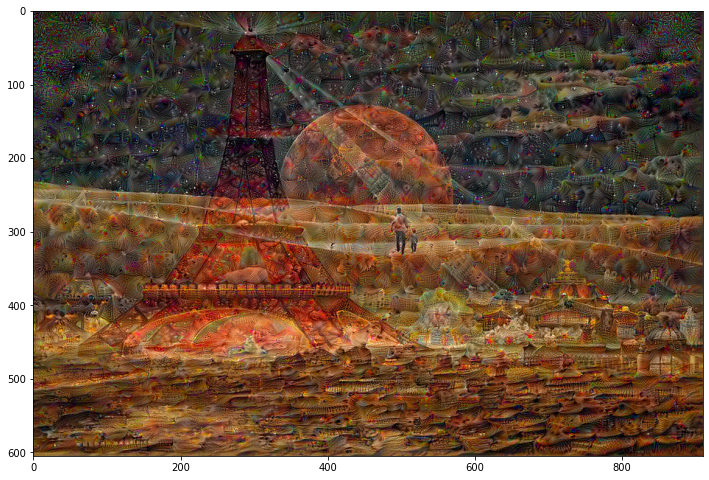

Step 1600, loss 2.2882838249206543


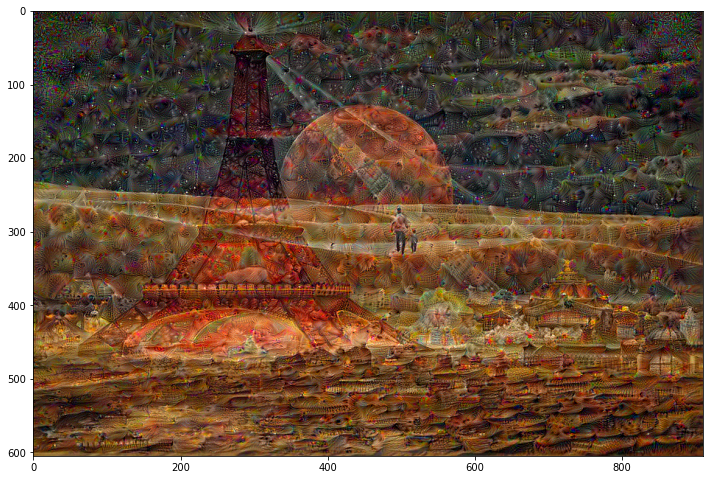

Step 1700, loss 2.314284563064575


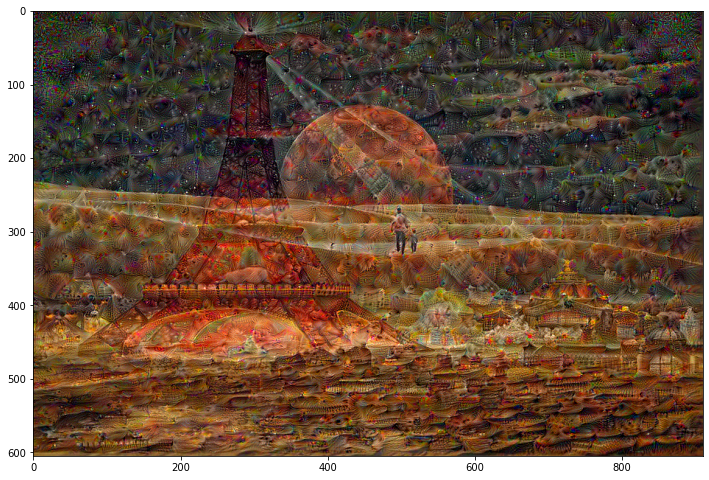

Step 1800, loss 2.338913917541504


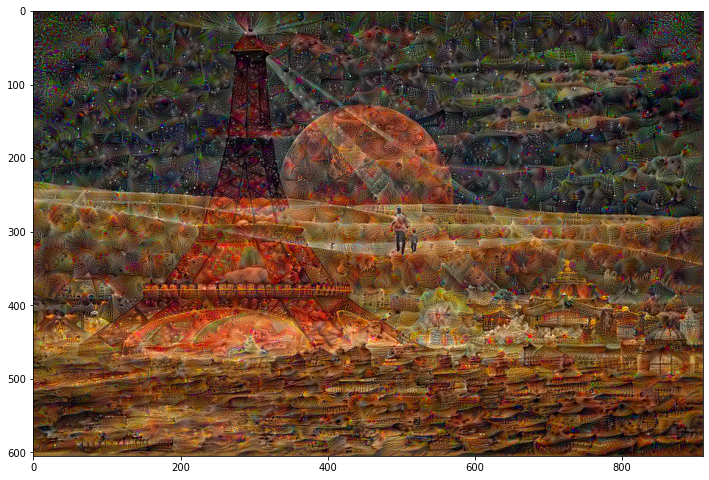

Step 1900, loss 2.3623008728027344


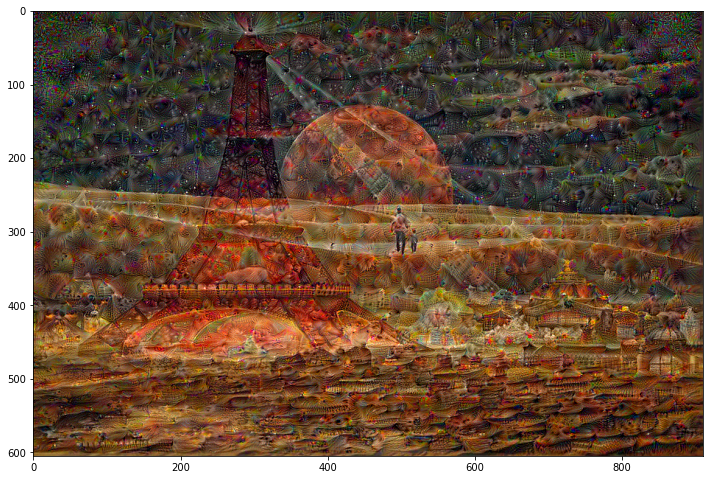

Step 2000, loss 2.3850457668304443


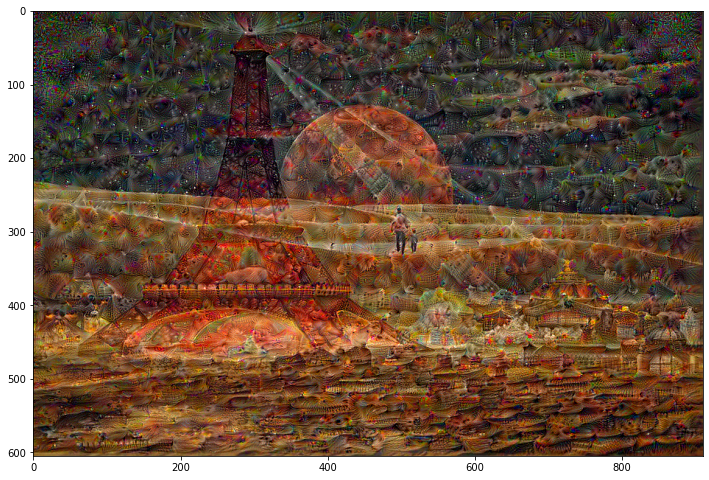

Step 2100, loss 2.406475067138672


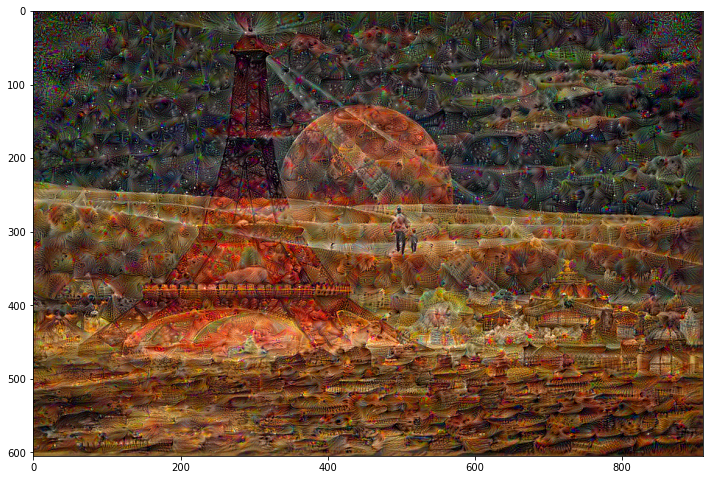

Step 2200, loss 2.4267196655273438


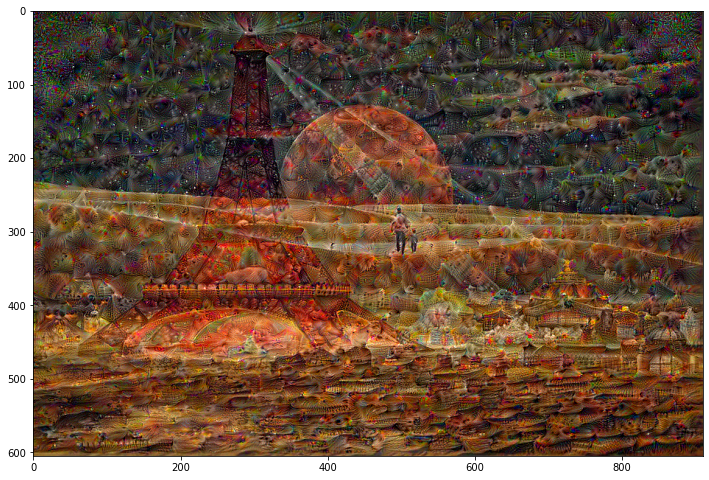

Step 2300, loss 2.4463868141174316


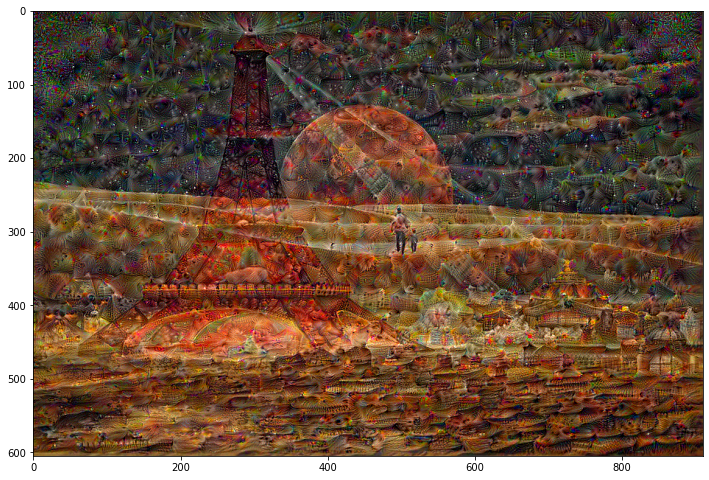

Step 2400, loss 2.4653537273406982


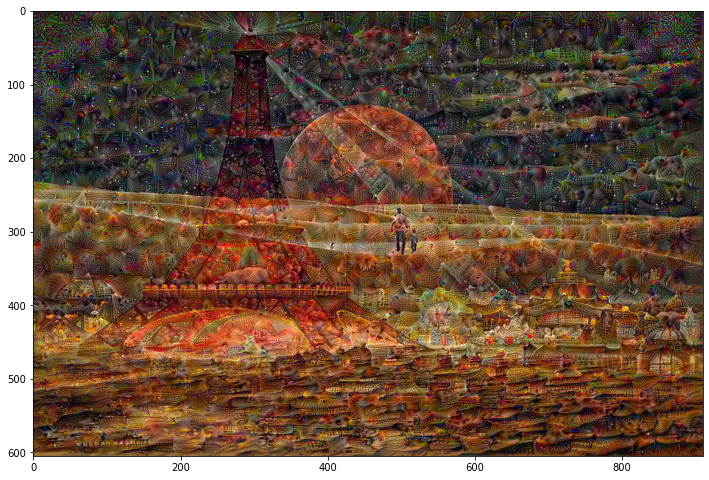

Step 2500, loss 2.483368158340454


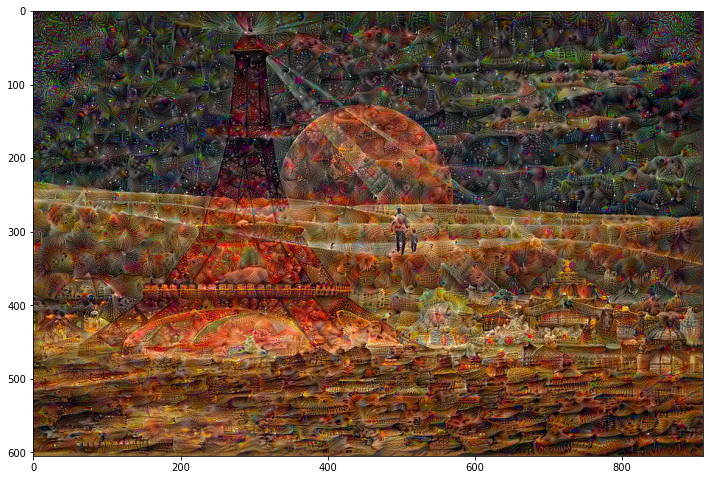

Step 2600, loss 2.5012216567993164


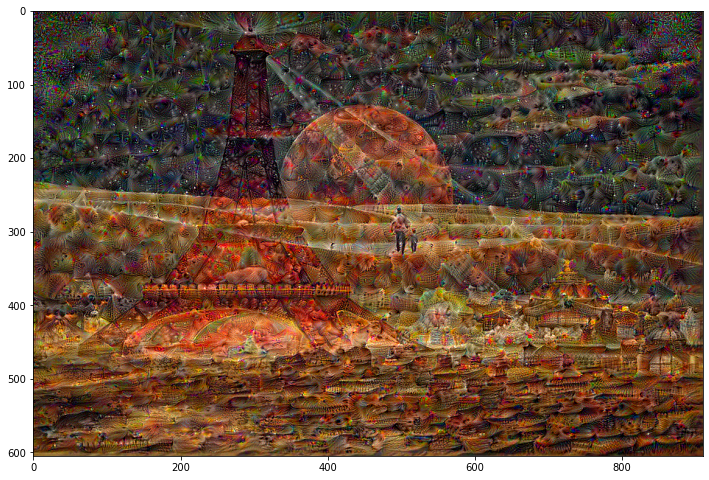

Step 2700, loss 2.518333911895752


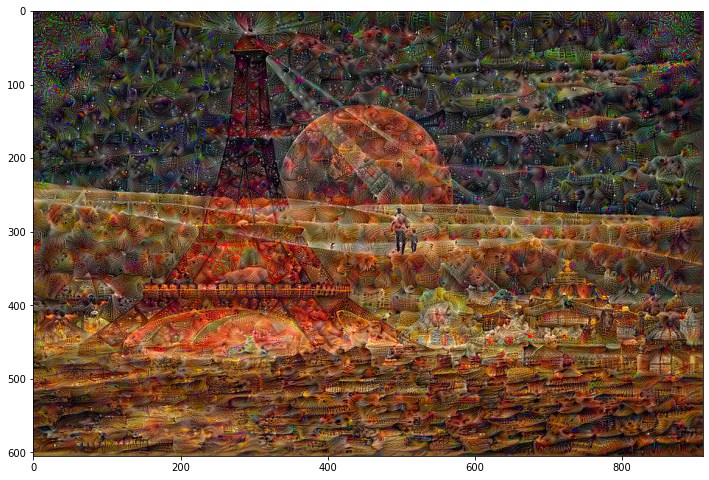

Step 2800, loss 2.534909963607788


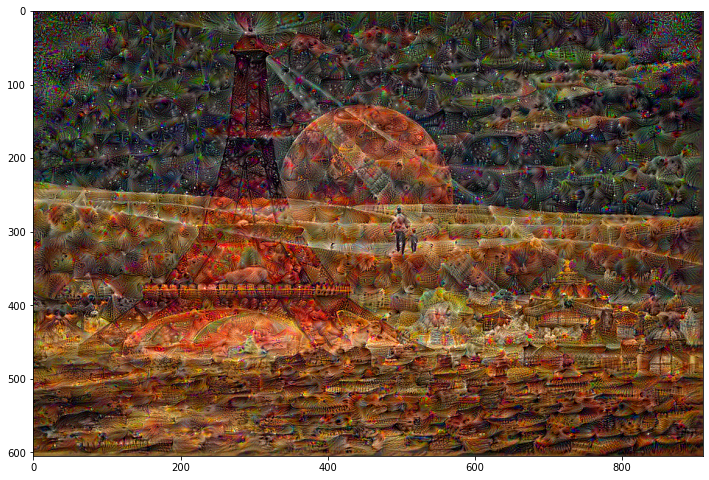

Step 2900, loss 2.550687551498413


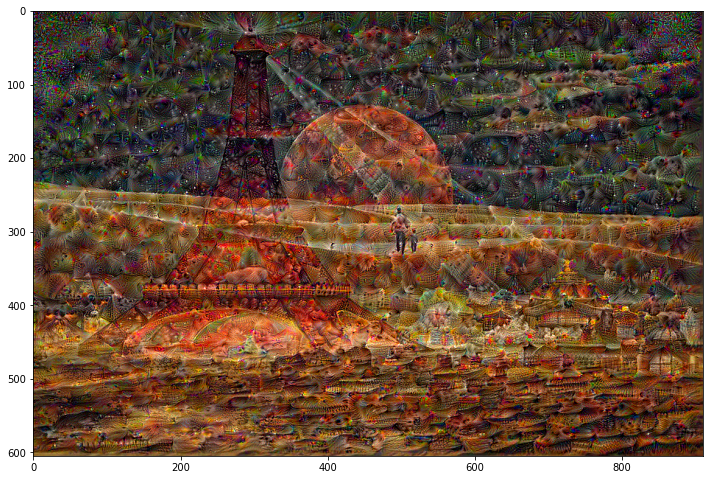

Step 3000, loss 2.5660862922668457


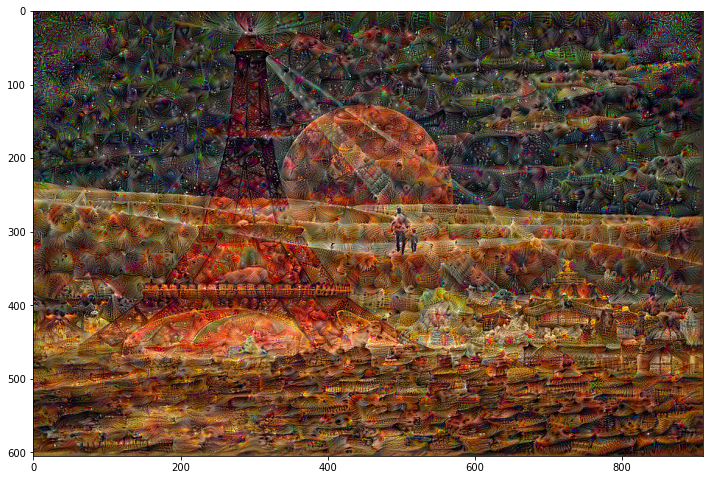

Step 3100, loss 2.581120014190674


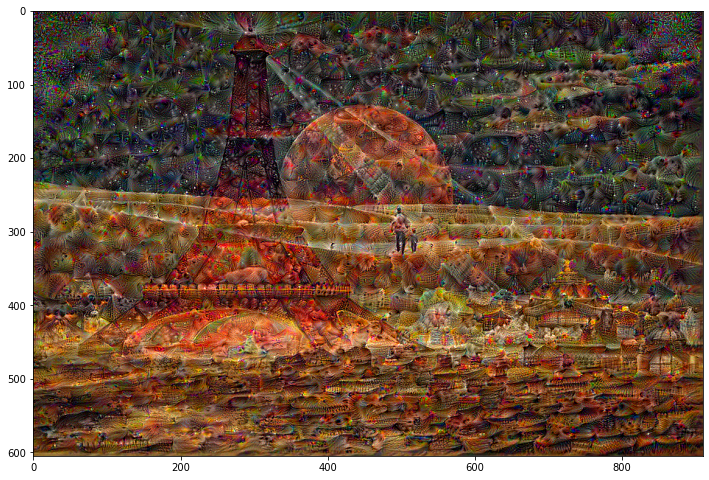

Step 3200, loss 2.5958986282348633


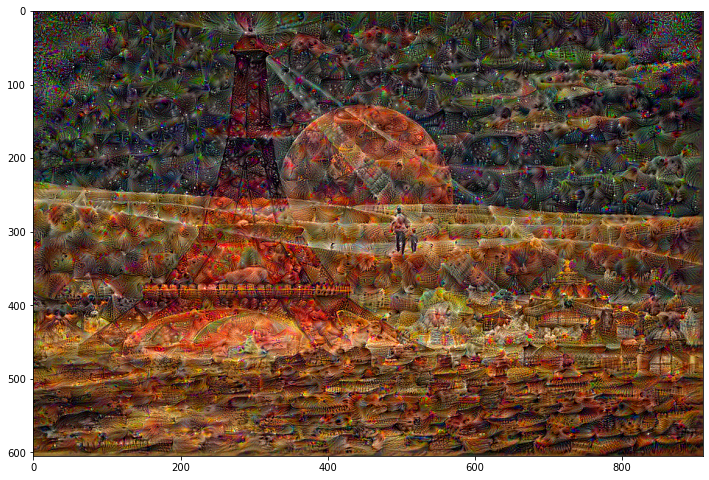

Step 3300, loss 2.6101226806640625


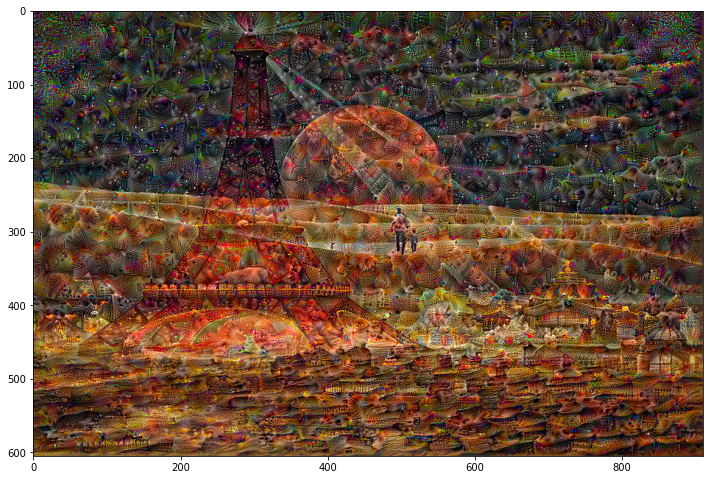

Step 3400, loss 2.62392520904541


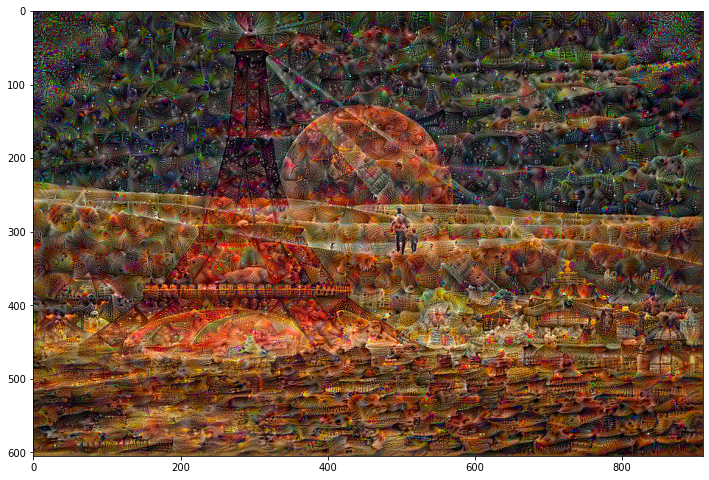

Step 3500, loss 2.6375699043273926


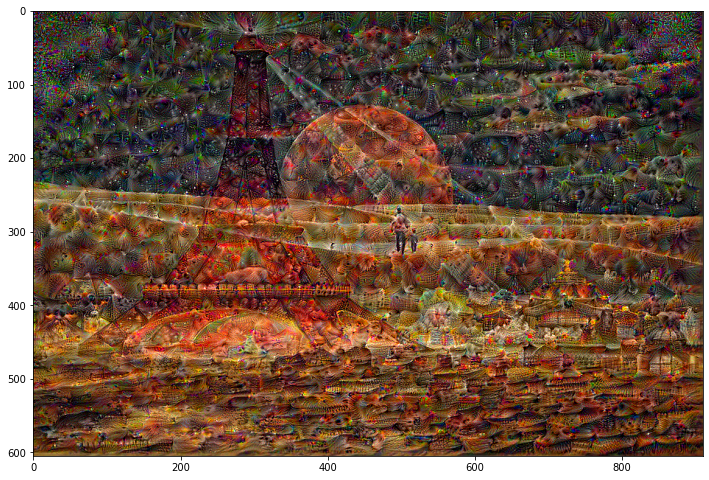

Step 3600, loss 2.650644540786743


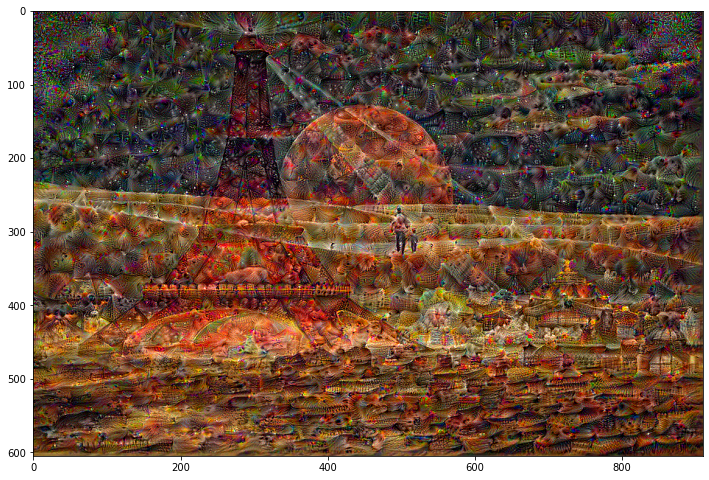

Step 3700, loss 2.6637487411499023


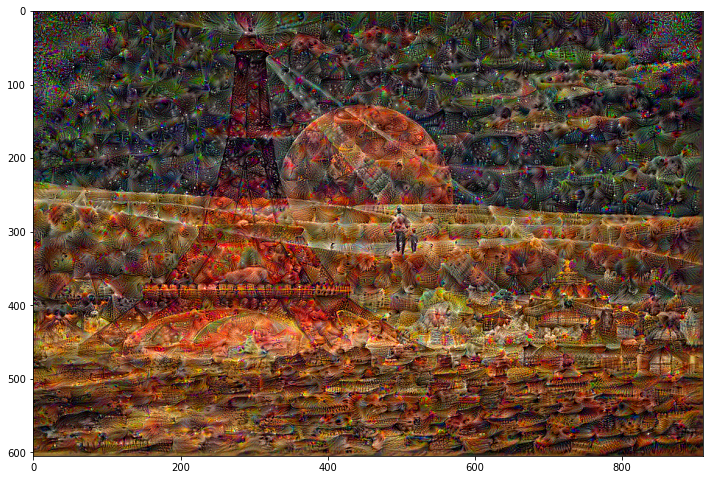

Step 3800, loss 2.676508903503418


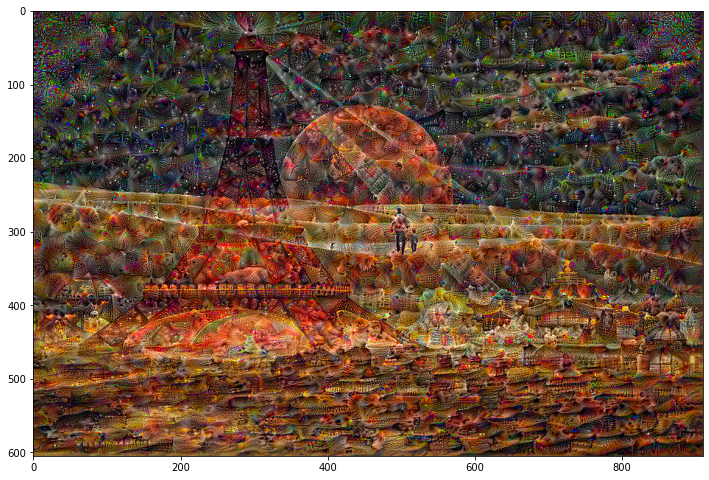

Step 3900, loss 2.689175605773926


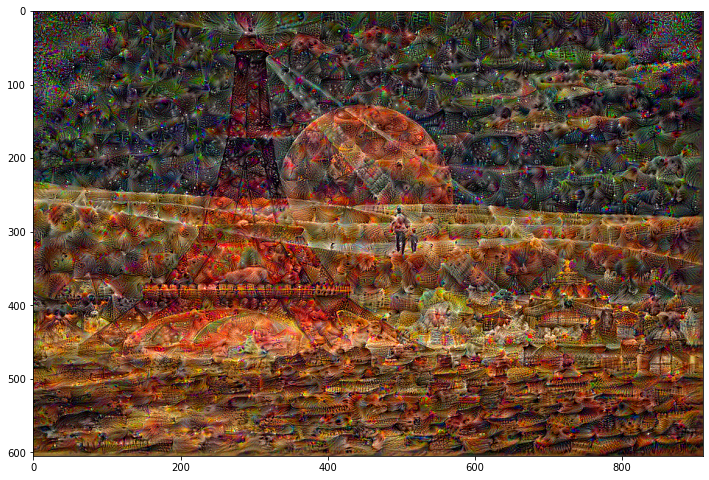

In [37]:
Sample_Image = np.array(tf.keras.preprocessing.image.load_img('img_0.jpg'))
dream_img = run_deep_dream_simple(model = deepdream_model, image = Sample_Image, steps = 4000, step_size = 0.001)